# GDAS - first-look data analysis for shot recordings

This notebook contains basic data visualization and analysis of the data collected with Stryde nodes at KAUST as part of the GDAS project on Dec 7 2023.

The dataset is acquired as follows:

- <font color='blue'>Receivers</font>

    1 line of 89 buried receivers, equally spaced by 2m for a total lenght of 178m.

    1 receiver placed near (and following) the source

- <font color='red'>Sources</font>

    13 sources on the right side of the receiver line at Point 2001, 2005, 2009, 2013, 2017, 2021, 2025, 2029, 2037, 2045, 2069, 2077, 2085 (8m or 16m distance)

    10 shots per source

In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

import numpy as np
import pylops
import matplotlib.pyplot as plt

from matplotlib.colors import SymLogNorm
from pylops.signalprocessing import FFT2D

from pystryde.reader import *
from pystryde.preproc import *
from pystryde.cmap import cmaps
from pystryde.visual import *

## Single shot

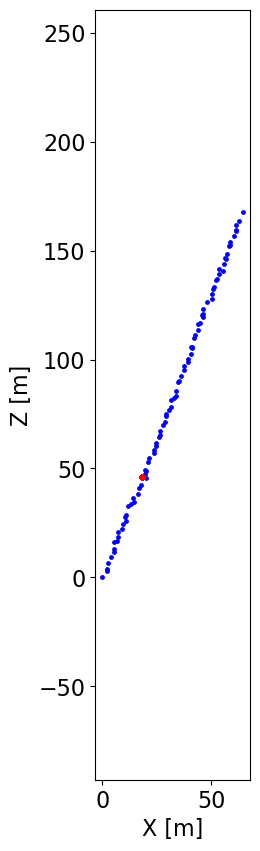

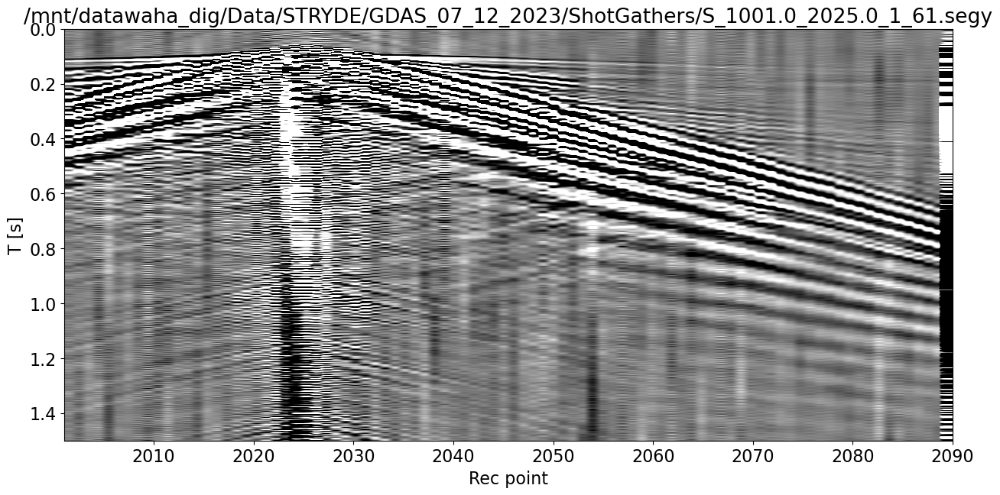

In [2]:
# SINGLE SHOT
filename = '/mnt/datawaha_dig/Data/STRYDE/GDAS_07_12_2023/ShotGathers/S_1001.0_2025.0_1_61.segy'
f = strydeshot(filename)
f.interpret()
f.getshot()
f.recx = f.recx.astype(np.float32)
f.recy = f.recy.astype(np.float32)
f.recx[f.recx==0] = np.nan
f.recx[np.isnan(f.recx)] = np.nanmean(f.recx)
f.recy[f.recy==0] = np.nan
f.recy[np.isnan(f.recy)] = np.nanmean(f.recy)

fig, ax = f.plotgeom(local=True, figsize=(2, 10))
ax.axis('equal')
plt.savefig('Figs/localgeometry.png', dpi=200, bbox_inches="tight")

f.plotshot(figsize=(15,7), itmax=1500, cmap='gray', clip=1e-3)
plt.savefig(f"Figs/{filename.split('/')[-1][:-5]}.png", dpi=200);

Let's now perform some basic filtering

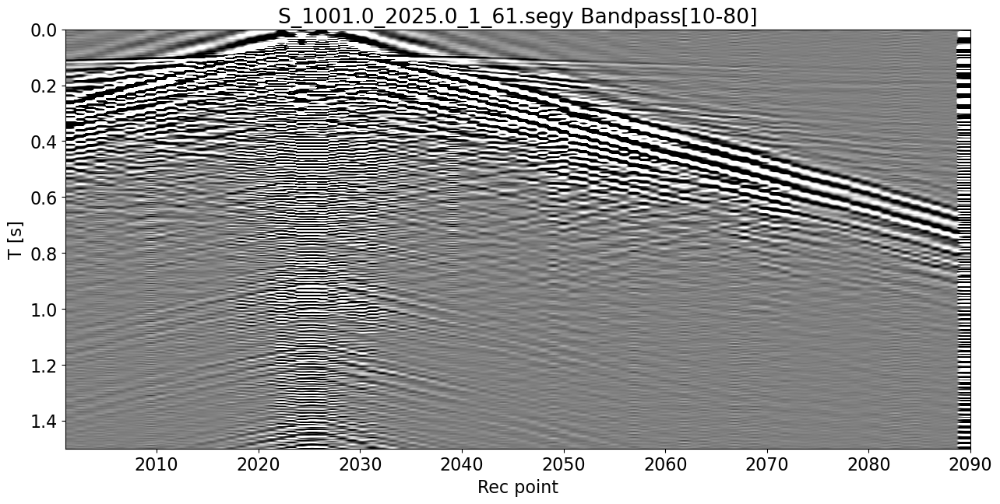

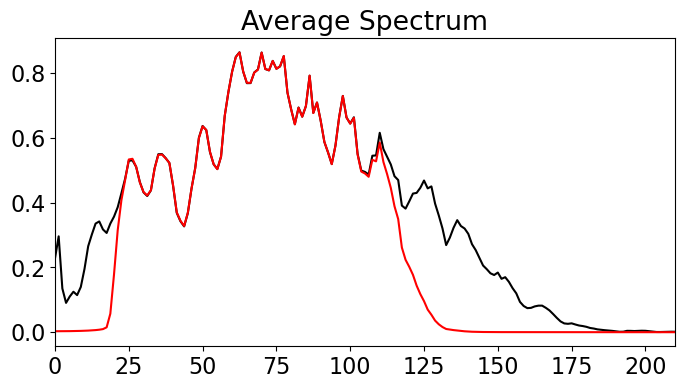

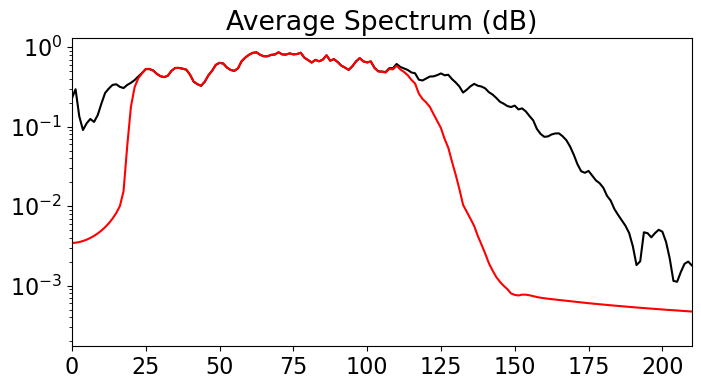

In [3]:
dfilt = f.filter(11, 20, 120, f.dt, plotflag=True, itmax_plot=1500, title=filename.split('/')[-1] + ' Bandpass[10-80]',
                 cmap='gray', vmin=-1e-3, vmax=1e-3, figsize=(15,7),
                 extent=(f.recpoint[0], f.recpoint[-1], f.t[1500], f.t[0]))
plt.savefig(f"Figs/{filename.split('/')[-1][:-5]}_filtered.png", dpi=200);

D, freq = averagespectrum(f.data[:, :800].T, f.dt)
Dfilt, freq = averagespectrum(dfilt[:, :800].T, f.dt)

plt.figure(figsize=(8, 4))
plt.plot(freq, np.abs(D), 'k')
plt.plot(freq, np.abs(Dfilt), 'r')
plt.title('Average Spectrum')
plt.xlim(0, 210)
plt.savefig(f"Figs/{filename.split('/')[-1][:-5]}_avspectrum.png", dpi=200)

plt.figure(figsize=(8, 4))
plt.semilogy(freq, np.abs(D), 'k')
plt.semilogy(freq, np.abs(Dfilt), 'r')
plt.title('Average Spectrum (dB)')
plt.xlim(0, 210)
plt.savefig(f"Figs/{filename.split('/')[-1][:-5]}_avspectrumdb.png", dpi=200);

## Entire survey

In [15]:
# Parameters for processing
tlims = [(20, 200),  (20, 600),  (20, 300), (5, 230),  (10, 200), 
         (10, 200),  (10, 200),  (1, 250),  (50, 300), (10, 300),
         (30, 250),  (50, 300),  (10, 250), ]
ishotmaster = [0, 0, 4, 0, 0, 0, 0, 0, 4, 0, 5, 0, 0]
filterd = [False, False, True, False, False, True, False, True, True, False, True, True, True]

t0s = [0.12, 0.08, 0.095, 0.04, 0.052, 0.070, 0.062, 0.027, 0.13, 0.030, 0.089, 0.129, 0.075]

print(len(tlims), len(ishotmaster), len(filterd), len(t0s))

# Shot to visualize
ishotplot = 3

print(tlims[ishotplot], ishotmaster[ishotplot], filterd[ishotplot], t0s[ishotplot])

13 13 13 13
(5, 230) 0 False 0.04


Data shape: (10, 1, 13, 90, 4000)
Working with shot 2013.0


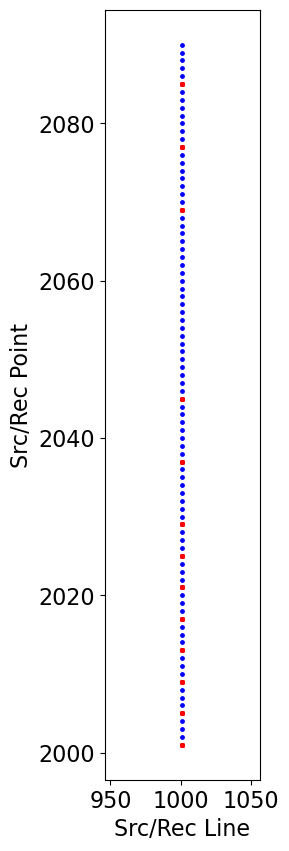

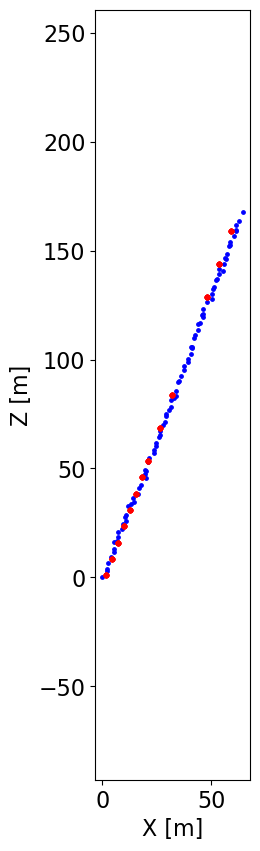

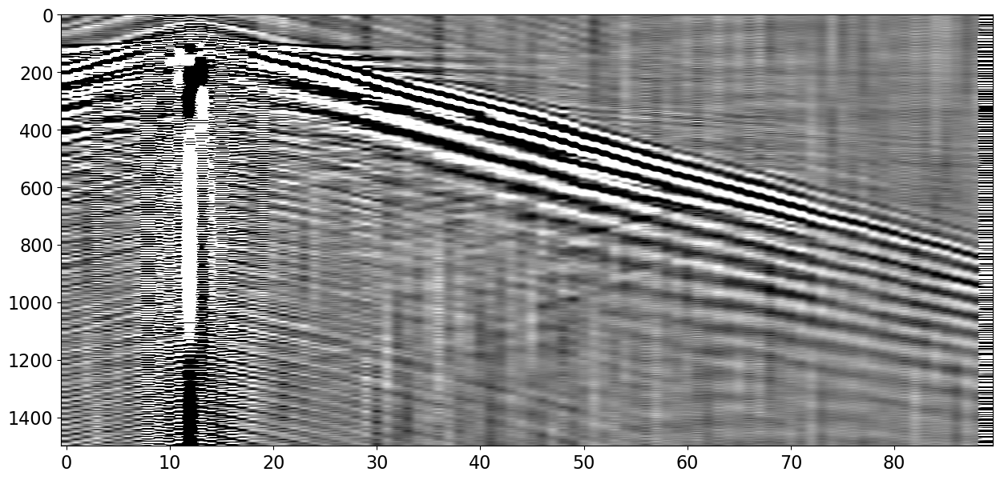

In [5]:
fs = strydeshots('/mnt/datawaha_dig/Data/STRYDE/GDAS_07_12_2023//ShotGathers/')
fs.interpret()
fs.getshot()

fs.recx = fs.recx.astype(np.float32)
fs.recy = fs.recy.astype(np.float32)
fs.recx[fs.recx==0] = np.nan
fs.recx[np.isnan(fs.recx)] = np.nanmean(fs.recx)
fs.recy[fs.recy==0] = np.nan
fs.recy[np.isnan(fs.recy)] = np.nanmean(fs.recy)

print('Data shape:', fs.data.shape)
print(f'Working with shot {fs.srcpoint_axis[ishotplot]}')

fs.plotgeom(coords=False, figsize=(2, 10))
fig, ax = fs.plotgeom(local=True, figsize=(2, 10))
ax.axis('equal')
plt.savefig('Figs/localsurveygeometry.png', dpi=200, bbox_inches='tight')

plt.figure(figsize=(15,7))
plt.imshow(fs.data[0, 0, ishotplot, :, :1500].T, cmap='gray', vmin=-1e-3, vmax=1e-3)
plt.axis('tight');

### Improve data alignment via cross-correlation

Let's start with a single shot location. We will use the traces at the closest receiver to find the best alignment

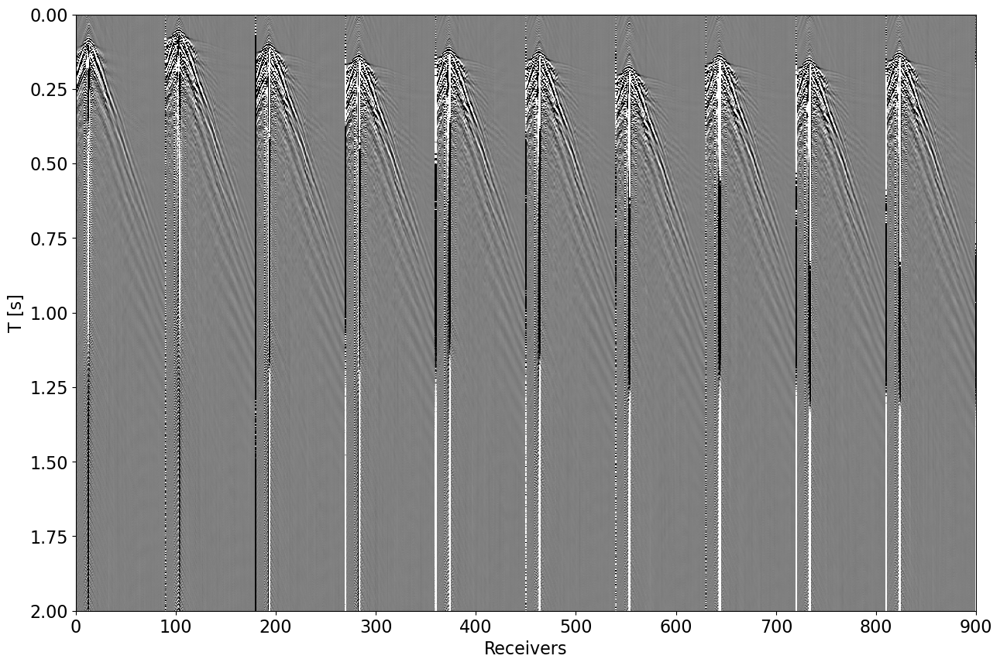

In [6]:
data = fs.data

fig, ax = plt.subplots(1, 1, figsize=(15, 10))
ax.imshow(data[:, 0, ishotplot].reshape(-1, fs.nt).T, 
          cmap='gray', vmin=-0.01, vmax=0.01, extent=(0, 90*10, fs.t[-1], 0))
ax.axis('tight')
ax.set_xlabel('Receivers')
ax.set_ylabel('T [s]')
ax.set_ylim(2., 0)
plt.savefig(f'Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_alldata.png', dpi=200, bbox_inches='tight');

Indices of max aligment: [224 176 137 158 150 100 137 123 146]
Indices of max aligment after shifts: [224 125 131 224 224 224 224 224 224]
Indices of max aligment after shifts (for otherdata): [224 125 131 224 224 224 224 224 224]


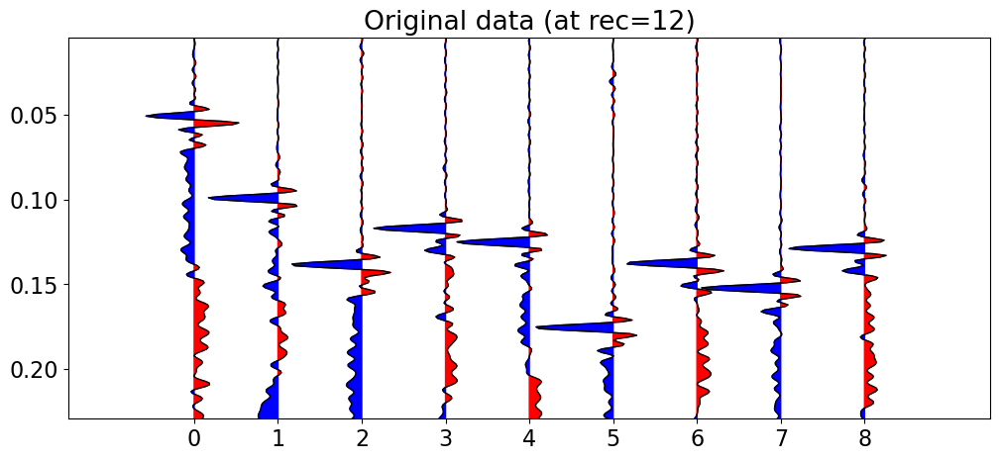

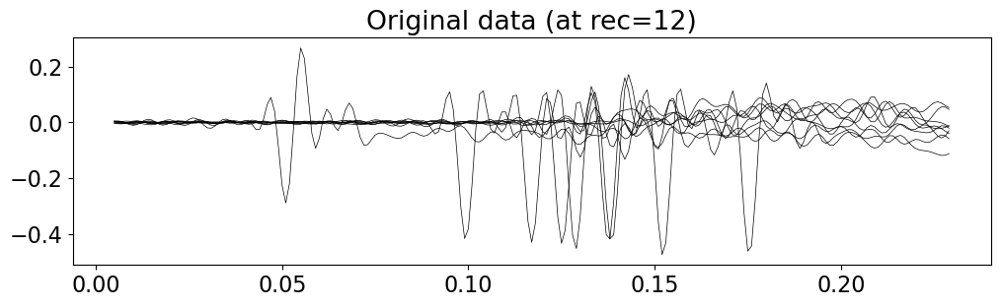

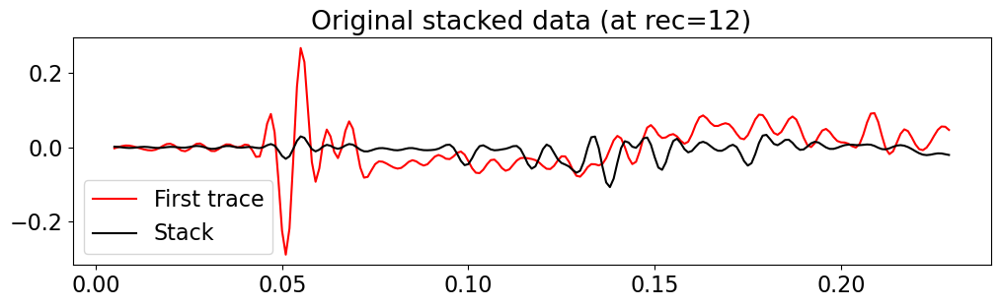

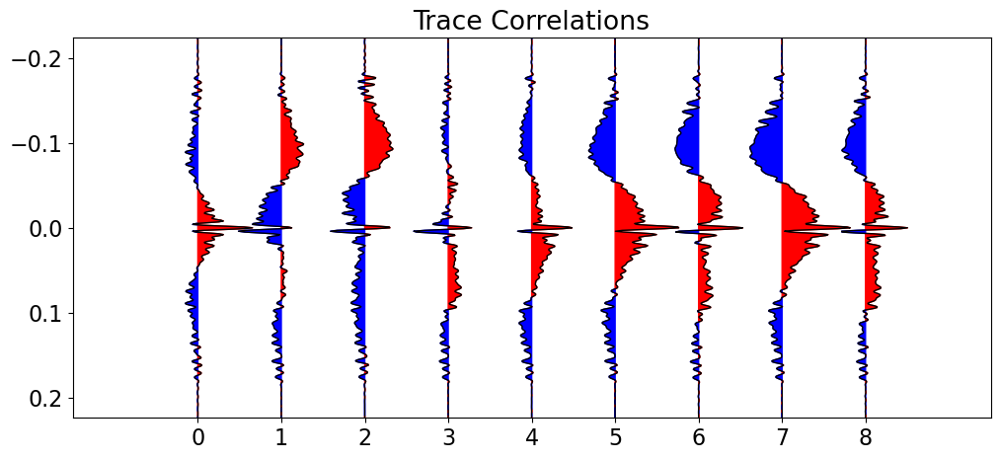

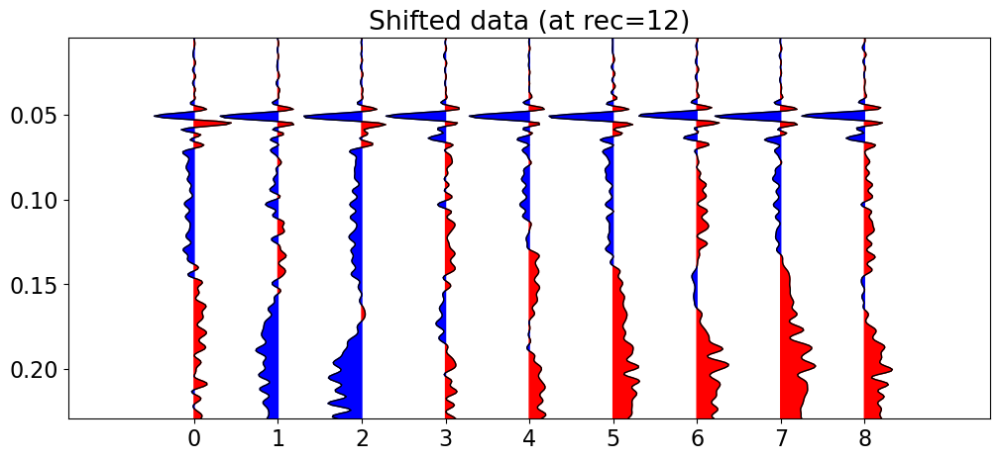

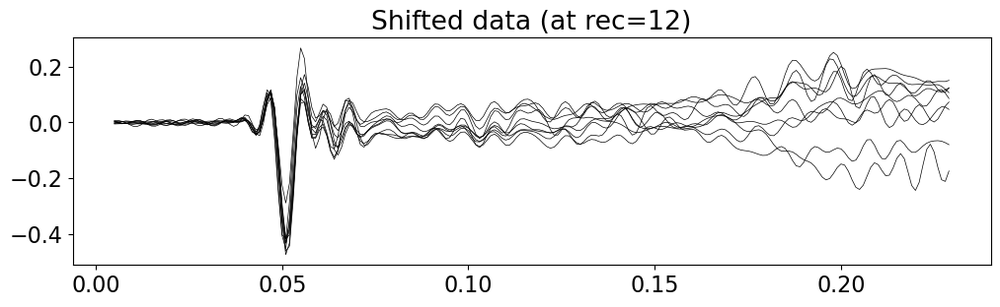

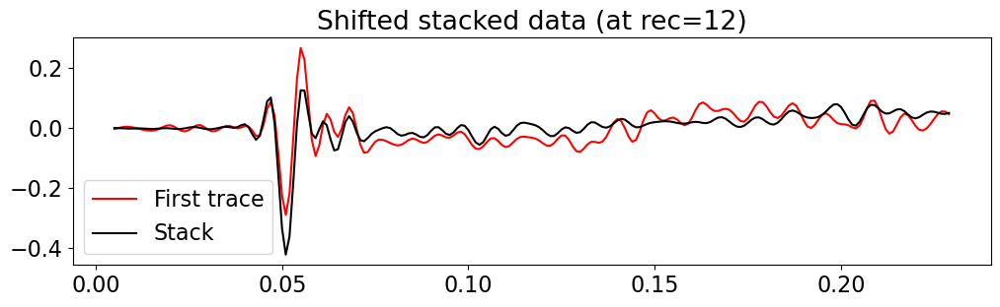

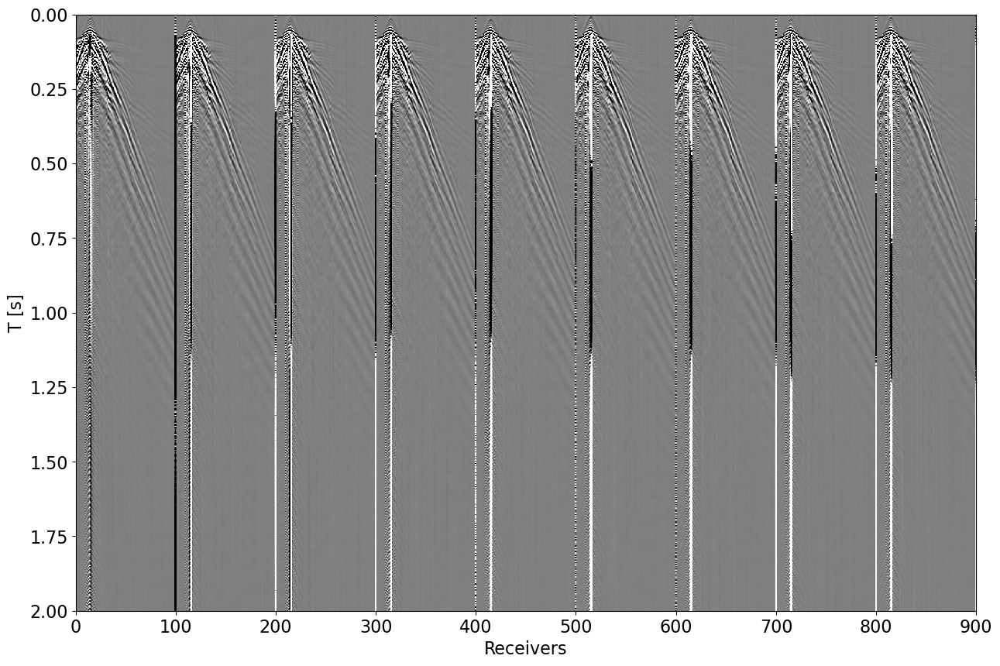

In [17]:
data = fs.data[1:]

# Filter away low freq noise in zero-offset
if filterd[ishotplot]:
    filtdata = filterdata(11, 20, 120, fs.dt, data[:, 0, ishotplot])[-1]
else:
    filtdata = data[:, 0, ishotplot].copy()

# Correct alignment
datashift, figs = aligndata(filtdata, np.where(fs.recpoint == fs.srcpoint_axis[ishotplot])[0][0], fs.t, 
                            tlims=tlims[ishotplot], ishotmaster=ishotmaster[ishotplot],
                            otherdata=data[:, 0, ishotplot], plotflag=True)
datashift = datashift[1]

figs[0].savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_crgoriginal.png", dpi=200)
figs[1].savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_crgoriginal_traceoverlay.png", dpi=200)
figs[2].savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_crgoriginal_traceoverlay1.png", dpi=200)
figs[3].savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_crgcorrs.png", dpi=200)
figs[4].savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_crgcorrected.png", dpi=200)
figs[5].savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_crgcorrected_traceoverlay.png", dpi=200)
figs[6].savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_crgcorrected_traceoverlay1.png", dpi=200)

fig, ax = plt.subplots(1, 1, figsize=(15, 10))
ax.imshow(datashift.reshape(-1, fs.nt).T, 
          cmap='gray', vmin=-0.01, vmax=0.01, extent=(0, 90*10, fs.t[-1], 0))
ax.axis('tight')
ax.set_xlabel('Receivers')
ax.set_ylabel('T [s]')
ax.set_ylim(2., 0);

Let's then do the same for all shots

In [8]:
datashift = np.zeros_like(data)
nshots = len(fs.srcpoint_axis)

for ishot in range(nshots):
    print(f'Working with shot {ishot}')
    irecalign = np.where(fs.recpoint == fs.srcpoint_axis[ishot])[0][0]

    # Filter away low freq noise in zero-offset
    if filterd:
        filtdata = filterdata(11, 20, 120, fs.dt, data[:, 0, ishot])[-1]
    else:
        filtdata = data[:, 0, ishot].copy()

    datashift[:, 0, ishot] = aligndata(filtdata, 
                                       irecalign, fs.t, tlims=tlims[ishot], ishotmaster=ishotmaster[ishot],
                                       otherdata=data[:, 0, ishot], plotflag=False)[0][1]
    """
    fig, ax = plt.subplots(1, 1, figsize=(15, 10))
    ax.imshow(datashift[:, 0, ishot].reshape(-1, fs.nt).T, 
              cmap='gray', vmin=-0.01, vmax=0.01, extent=(0, 90*10, fs.t[-1], 0))
    ax.axis('tight')
    ax.set_xlabel('Receivers')
    ax.set_ylabel('T [s]')
    ax.set_ylim(2., 0);
    """

Working with shot 0
Indices of max aligment: [179 250 218 151 274 203 207 204 197]
Indices of max aligment after shifts: [179 179 179 179 179 179 179 179 179]
Indices of max aligment after shifts (for otherdata): [179 179 179 179 179 179 179 179 179]
Working with shot 1
Indices of max aligment: [579 597 555 573 574 598 511 543 556]
Indices of max aligment after shifts: [579 579 579 579 579 579 579 579 579]
Indices of max aligment after shifts (for otherdata): [579 579 579 579 579 579 579 579 579]
Working with shot 2
Indices of max aligment: [266 286 267 208 279 286 298 279 342]
Indices of max aligment after shifts: [279 279 279 279 279 279 279 279 279]
Indices of max aligment after shifts (for otherdata): [279 279 279 279 279 279 279 279 279]
Working with shot 3
Indices of max aligment: [224 175 136 157 149  99 137 122 145]
Indices of max aligment after shifts: [224 224 224 224 224 224 224 224 224]
Indices of max aligment after shifts (for otherdata): [224 224 224 224 224 224 224 224 2

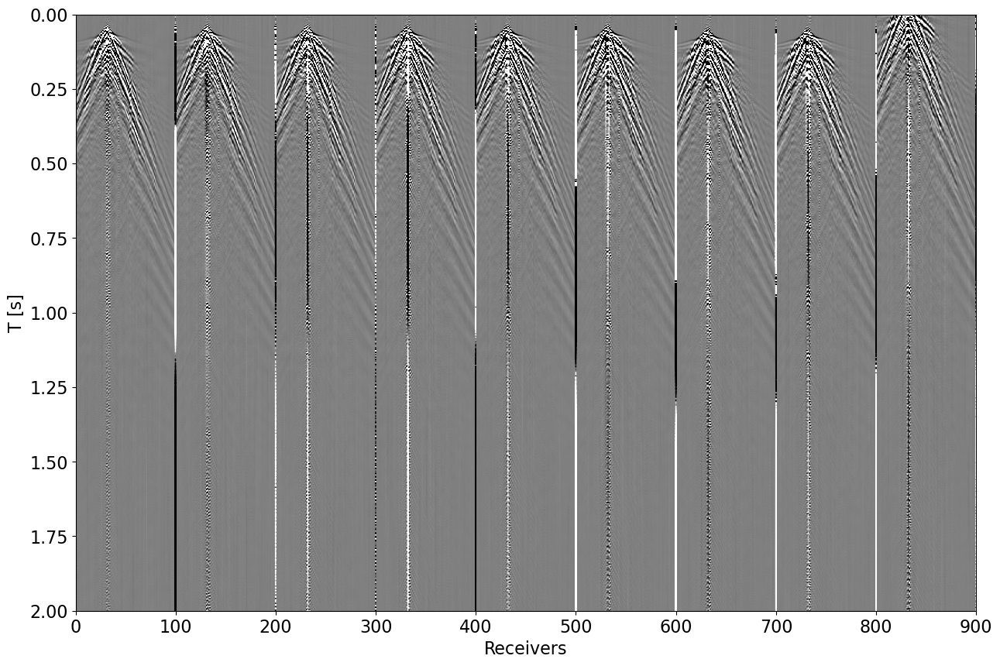

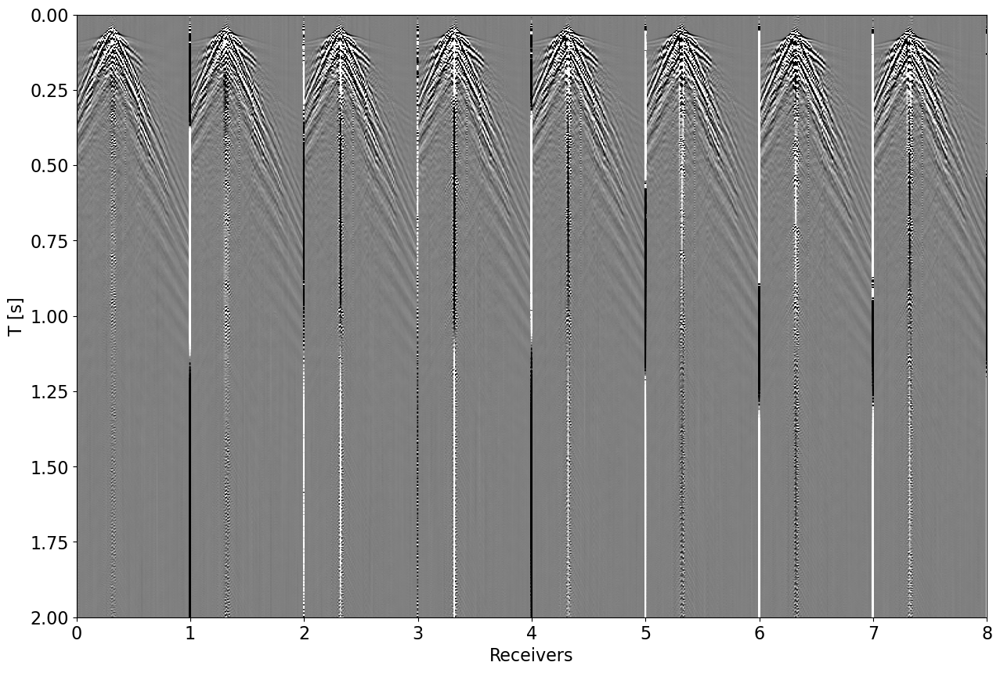

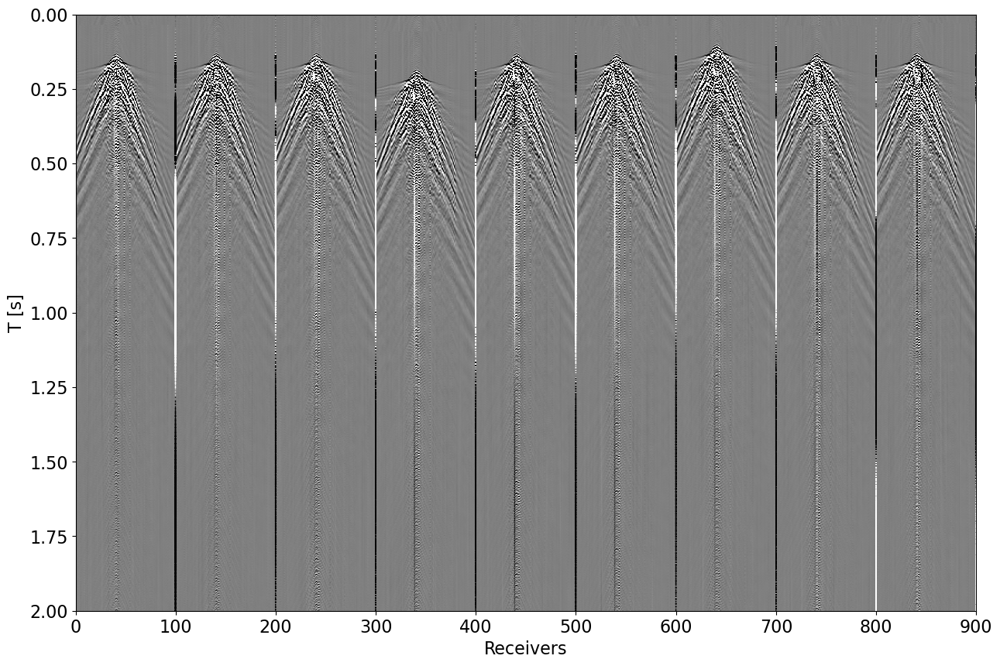

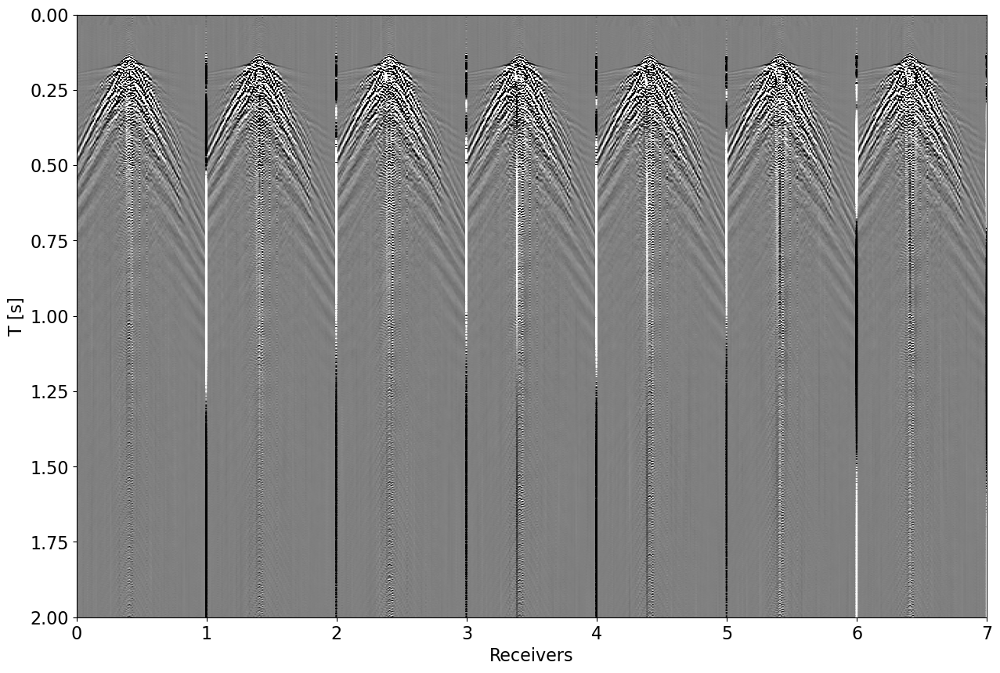

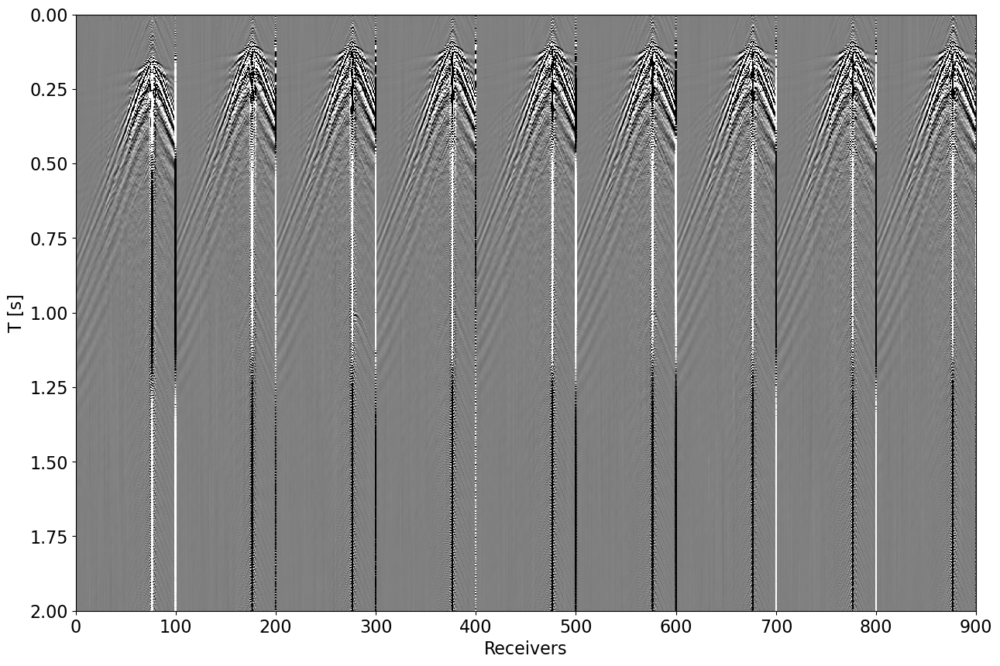

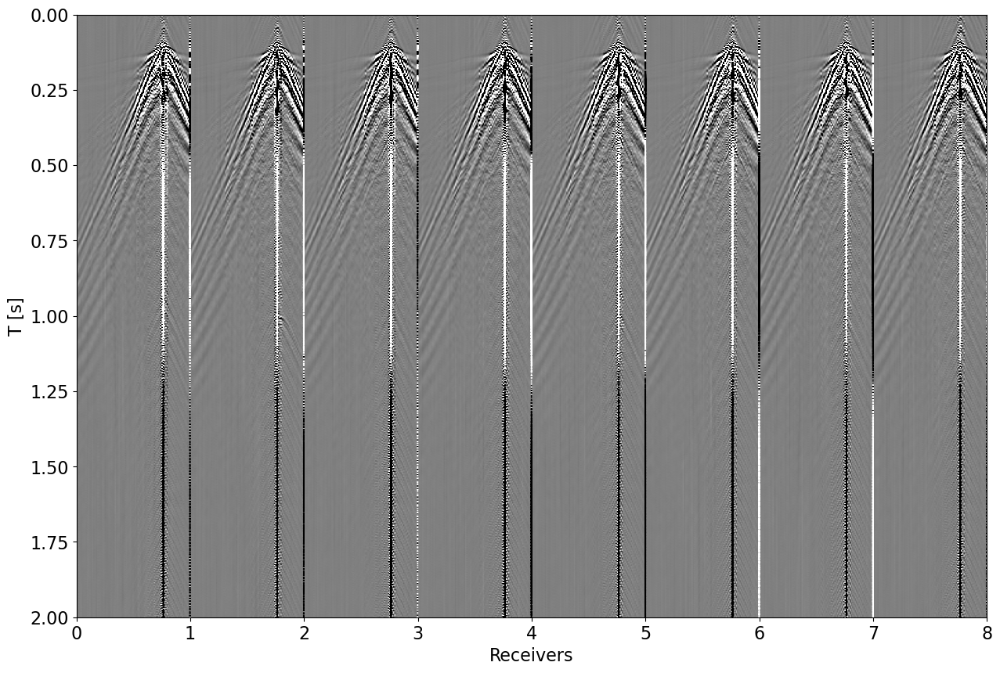

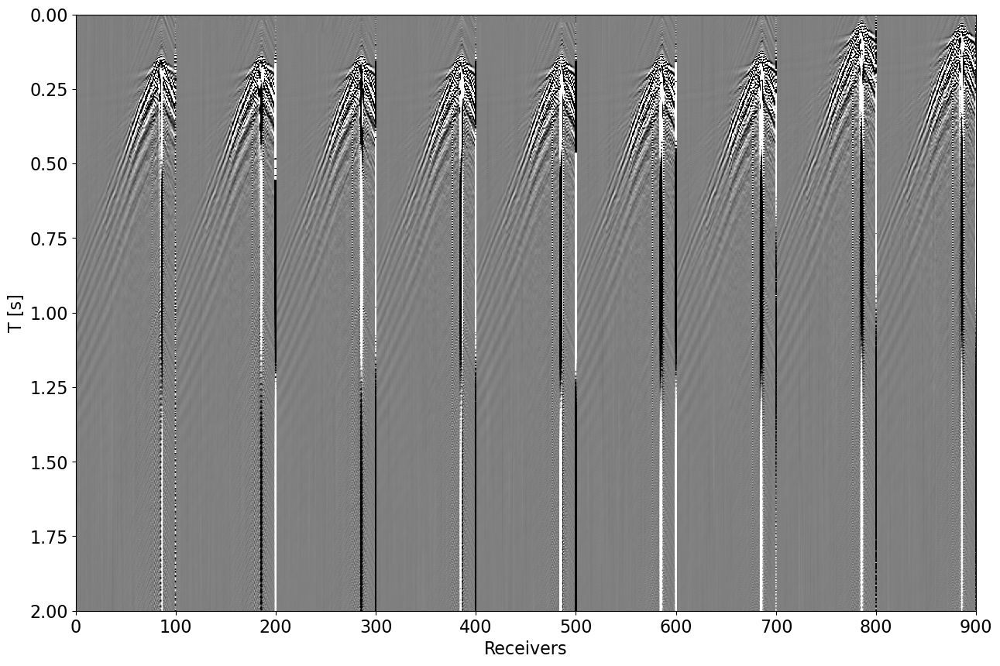

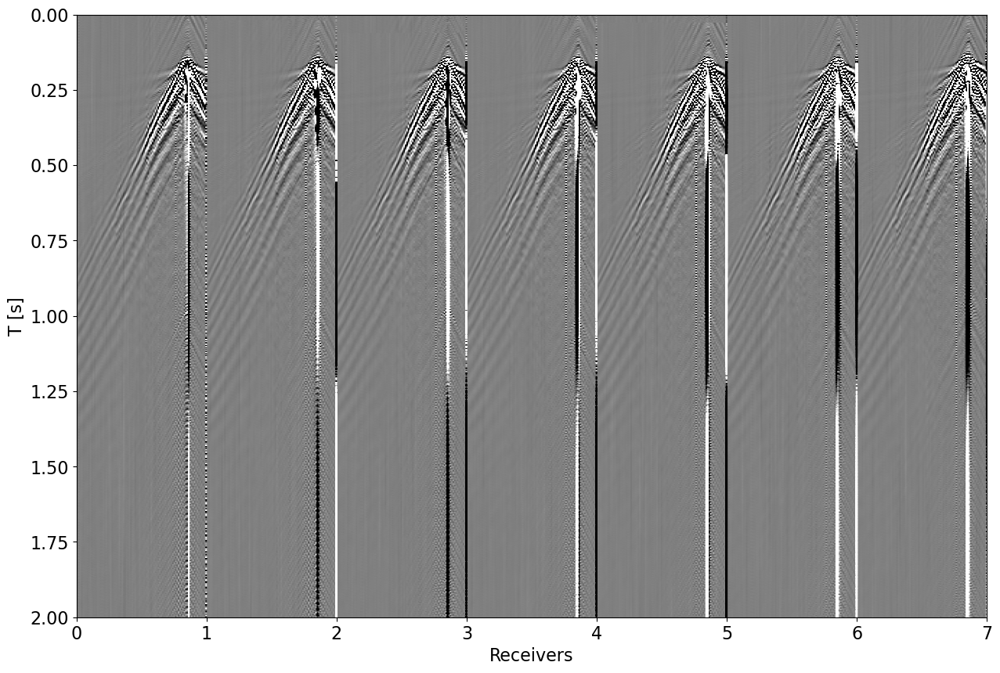

In [9]:
# Average data, but first removing what is not aligned properly
ishots_remove = [[], [], [], [], [], [], [], [-1,], [3, 6], [], [0], [-2, -1], [], ]    

datashiftstacked = np.zeros((nshots, fs.nr, fs.nt))
for ishot in range(nshots):
    datatostack = datashift.squeeze()[:, ishot]
    datatostack = np.delete(datatostack, ishots_remove[ishot], 0)
    datashiftstacked[ishot] = np.mean(datatostack, axis=0)
    
    if len(ishots_remove[ishot]) > 0:
        fig, ax = plt.subplots(1, 1, figsize=(15, 10))
        ax.imshow(datashift[:, 0, ishot].reshape(-1, fs.nt).T, 
                  cmap='gray', vmin=-0.01, vmax=0.01, extent=(0, 90*10, fs.t[-1], 0))
        ax.axis('tight')
        ax.set_xlabel('Receivers')
        ax.set_ylabel('T [s]')
        ax.set_ylim(2., 0)
        
        fig, ax = plt.subplots(1, 1, figsize=(15, 10))
        ax.imshow(datatostack.reshape(-1, fs.nt).T, 
                  cmap='gray', vmin=-0.01, vmax=0.01, extent=(0, datatostack.shape[0], fs.t[-1], 0))
        ax.axis('tight')
        ax.set_xlabel('Receivers')
        ax.set_ylabel('T [s]')
        ax.set_ylim(2., 0)

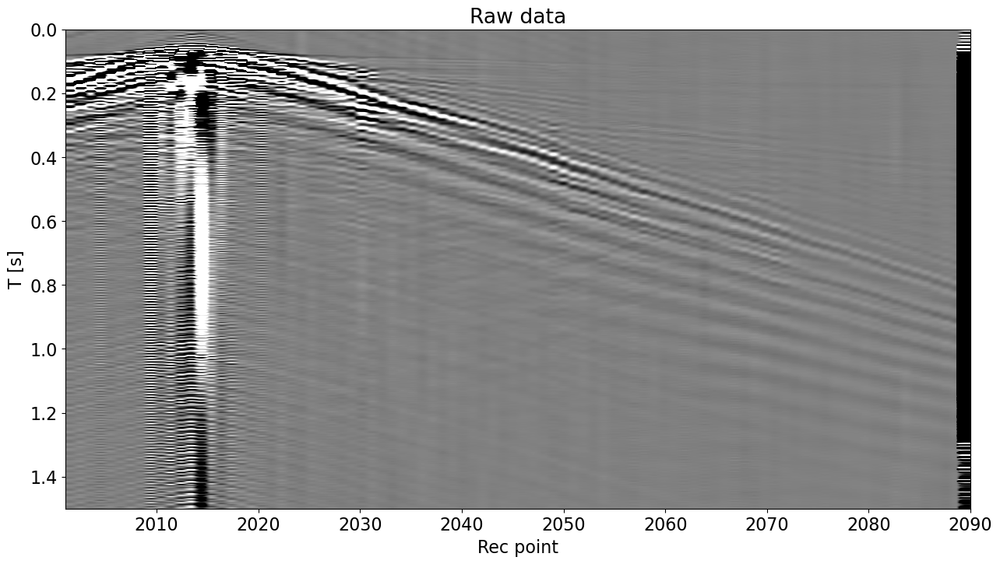

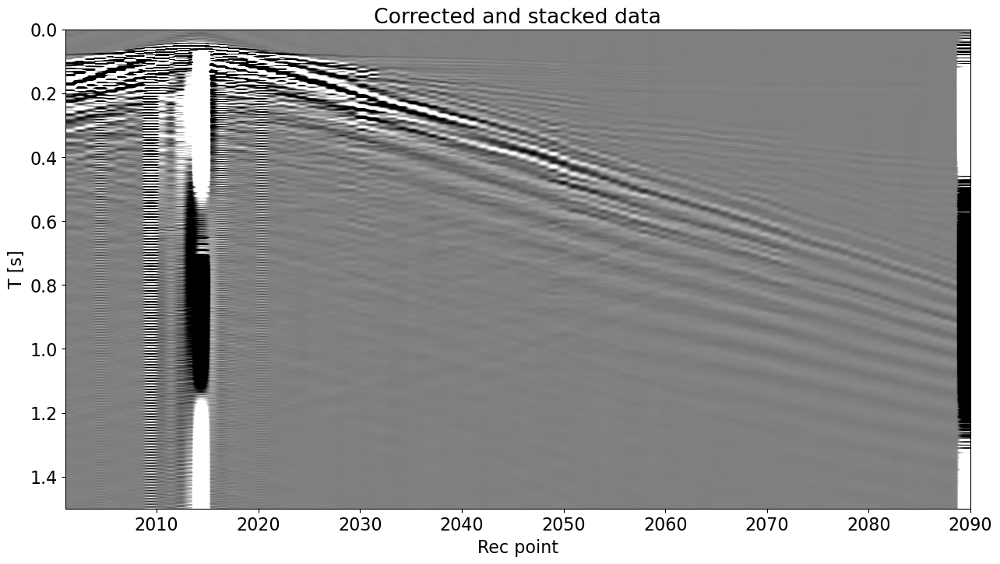

In [10]:
# Display one shot before and after stacking
itmax = 1500

plt.figure(figsize=(15, 8))
plt.imshow(data[0, 0, ishotplot, :, :itmax].T, cmap='gray', vmin=-1e-2, vmax=1e-2, 
           extent=(f.recpoint[0], f.recpoint[-1], f.t[itmax], f.t[0]))
plt.axis('tight')
plt.xlabel('Rec point')
plt.ylabel('T [s]')
plt.title('Raw data')
plt.savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_rawdata.png", dpi=200)

plt.figure(figsize=(15, 8))
plt.imshow(datashiftstacked[ishotplot, :, :itmax].T, cmap='gray', vmin=-1e-2, vmax=1e-2, 
           extent=(f.recpoint[0], f.recpoint[-1], f.t[itmax], f.t[0]))
plt.axis('tight')
plt.xlabel('Rec point')
plt.ylabel('T [s]')
plt.title('Corrected and stacked data')
plt.savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishotplot])}_optimalStackeddata.png", dpi=200);

Finally, we align manually to absolute t0

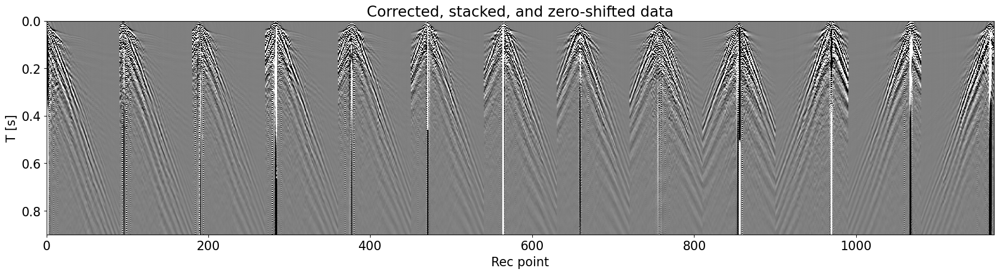

In [11]:
nt = 900
datafinal = np.concatenate([dat[:, int(t0 // fs.dt):][np.newaxis, :, :nt] for dat, t0 in zip(datashiftstacked, t0s)])
datafinal = datafinal[:, :89]

plt.figure(figsize=(22, 5))
plt.imshow(datafinal.reshape(-1, nt).T, cmap='gray', vmin=-1e-2, vmax=1e-2, 
           extent=(0, datashiftstacked.shape[0]*datashiftstacked.shape[1], f.t[nt], f.t[0]))
plt.axis('tight')
plt.xlabel('Rec point')
plt.ylabel('T [s]')
plt.title('Corrected, stacked, and zero-shifted data')
plt.savefig(f"Figs/Alldata_optimalstackedshifteddata.png", dpi=200)

# Save data
np.savez('Data_final_GDAS', data=datafinal, t = np.arange(nt)*fs.dt, recpoint=fs.recpoint, srcpoint=fs.srcpoint_axis,
         recx = np.arange(89) * 2, srcx = (fs.srcpoint_axis - fs.srcpoint_axis.min()) * 2)

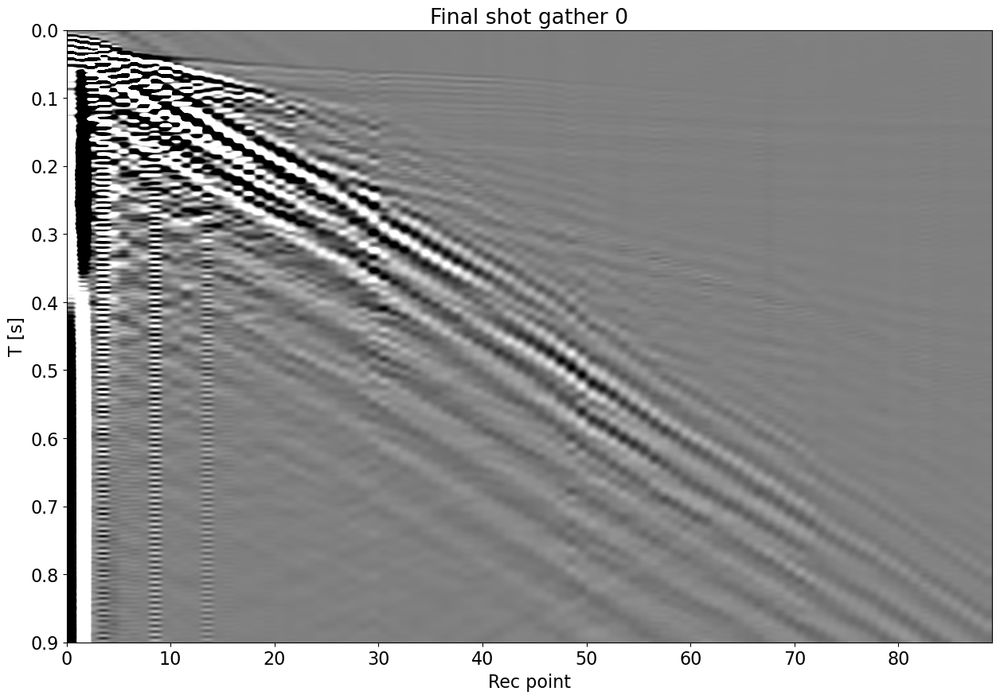

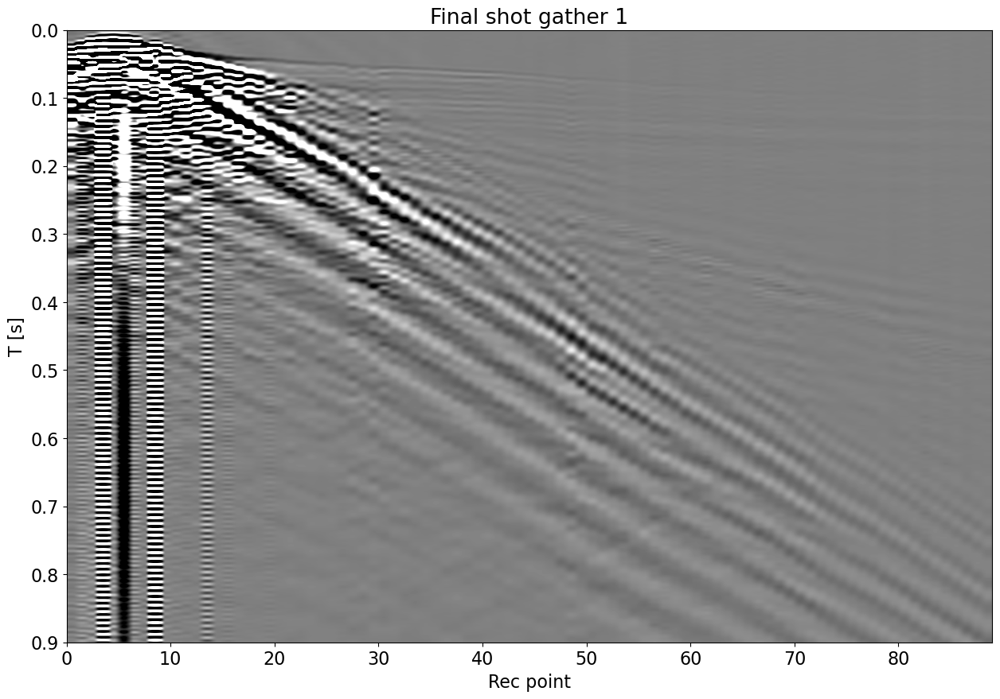

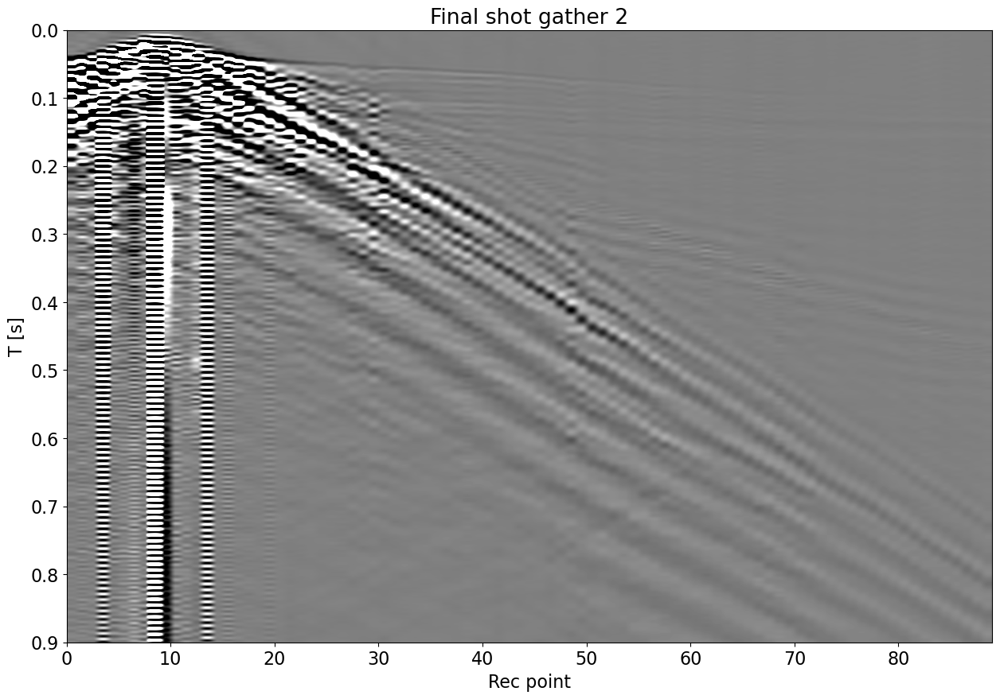

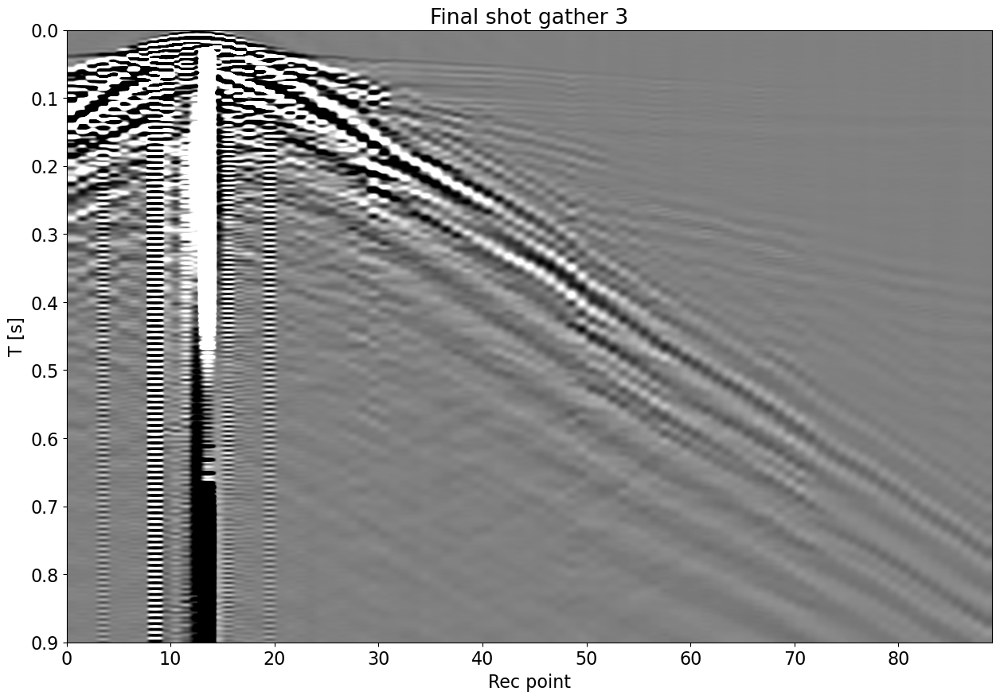

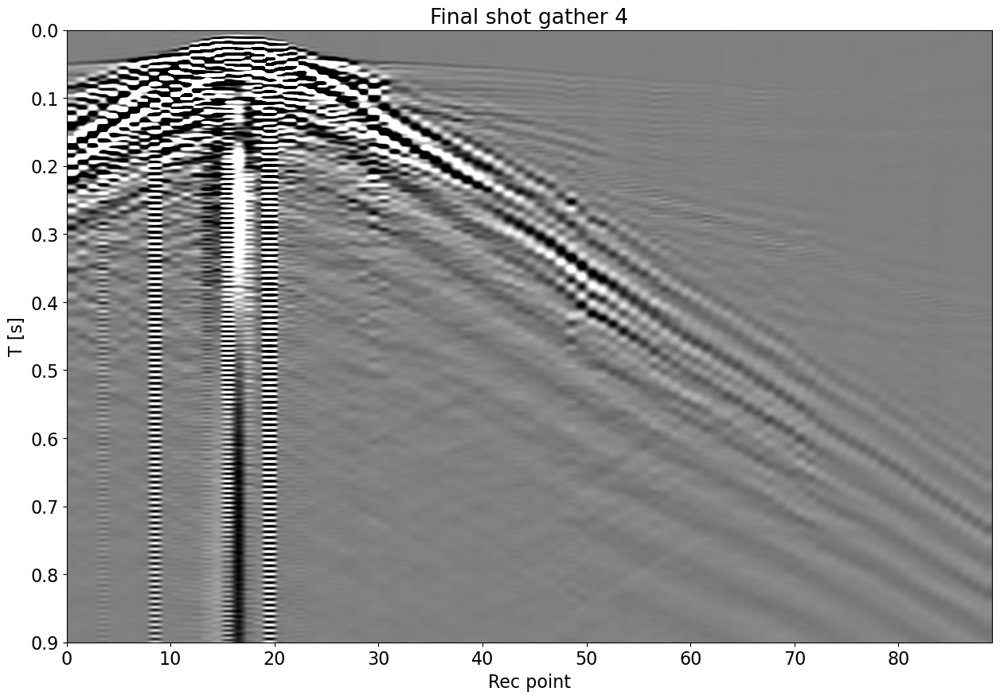

...

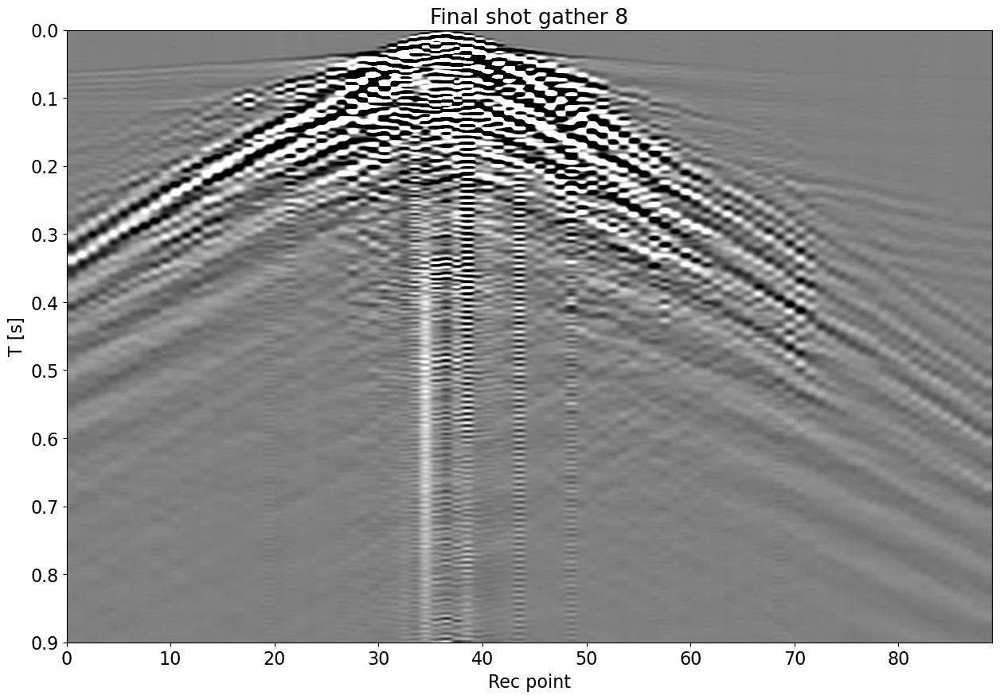

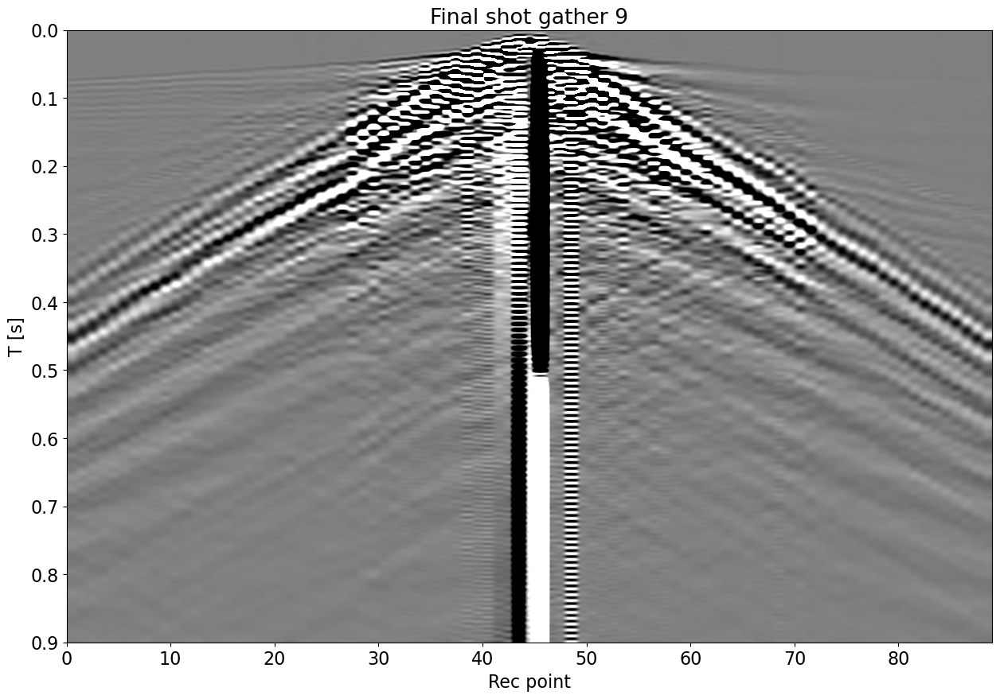

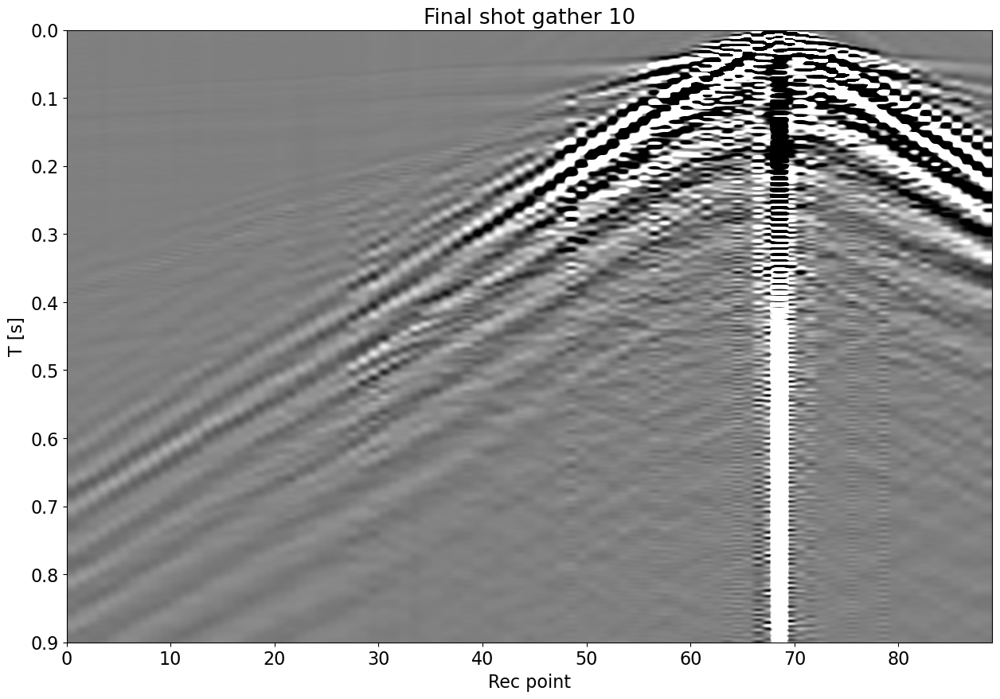

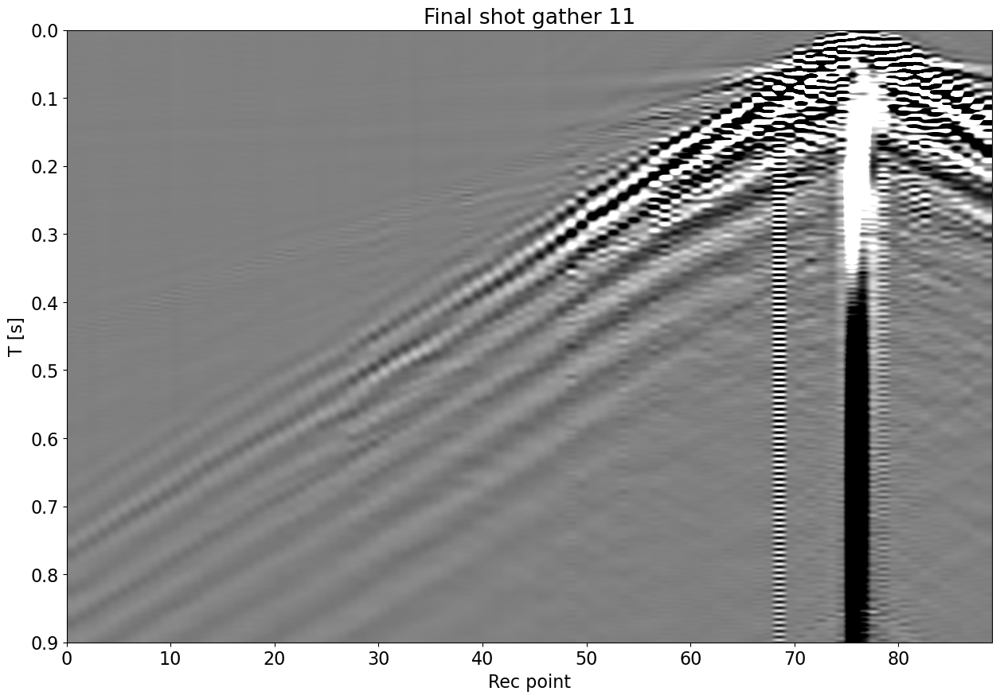

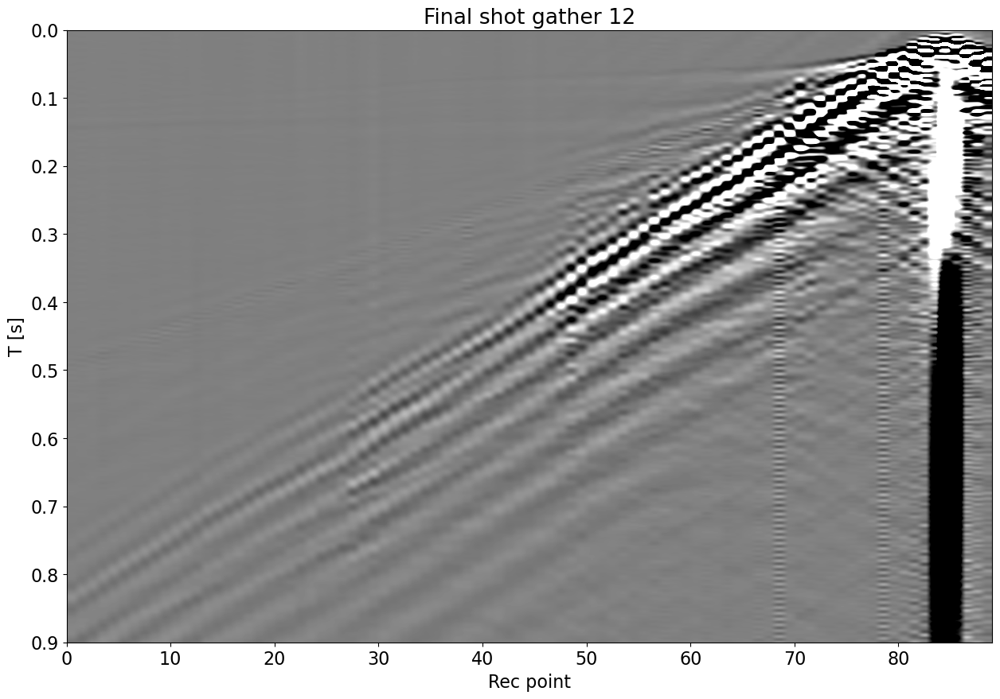

In [12]:
nr = datafinal[0].shape[0]
for ishot in range(datafinal.shape[0]):
    datanorm = datafinal[ishot]
    datanorm.max()
    plt.figure(figsize=(15, 10))
    plt.imshow(datafinal[ishot].T, cmap='gray', vmin=-1e-2, vmax=1e-2, 
            extent=(0, nr, f.t[nt], f.t[0]))
    plt.axis('tight')
    plt.xlabel('Rec point')
    plt.ylabel('T [s]')
    plt.title(f'Final shot gather {ishot}')
    plt.savefig(f"Figs/Shot_{int(fs.srcpoint_axis[ishot])}_finaldata.png", dpi=200);

## Bandpass data

First, let's compare the spectra of each shot

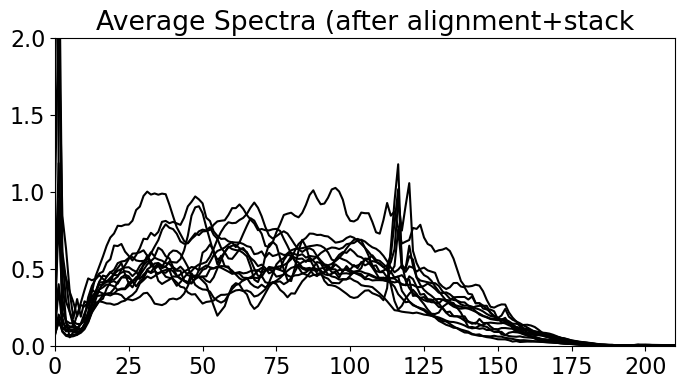

In [13]:
_, freq = averagespectrum(datafinal[0, :, :800].T, fs.dt)
Ds = np.vstack([averagespectrum(d[:, :800].T, fs.dt)[0] for d in datafinal])

plt.figure(figsize=(8, 4))
plt.plot(freq, np.abs(Ds).T, 'k')
plt.title('Average Spectra (after alignment+stack')
plt.xlim(0, 210)
plt.ylim(0, 2)
plt.savefig(f"Figs/Data_avspectrum.png", dpi=200)

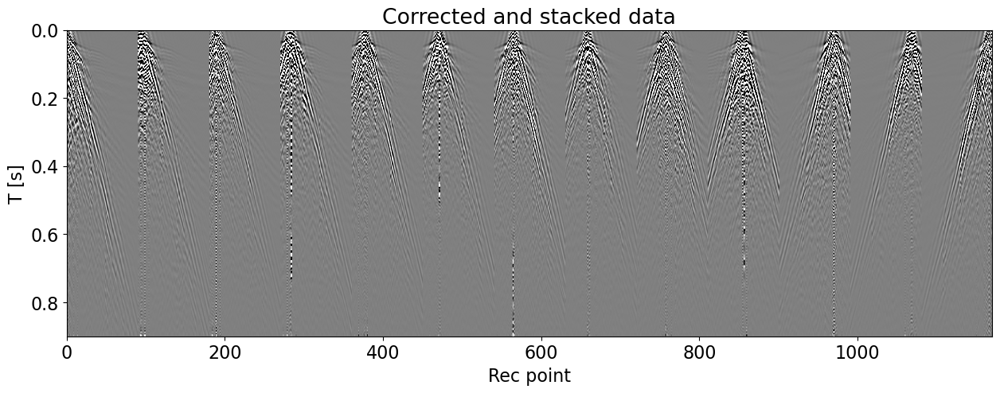

In [14]:
datafilt = np.concatenate([filterdata(11, 20, 110, fs.dt, np.pad(datafinal[ishot], ((0,0),(200,0))))[-1][:, 200:][np.newaxis] for ishot in range(datafinal.shape[0])])

plt.figure(figsize=(15, 5))
plt.imshow(datafilt.reshape(-1, nt).T, cmap='gray', vmin=-1e-2, vmax=1e-2, 
           extent=(0, datashiftstacked.shape[0]*datashiftstacked.shape[1], f.t[nt], f.t[0]))
plt.axis('tight')
plt.xlabel('Rec point')
plt.ylabel('T [s]')
plt.title('Corrected and stacked data')
plt.savefig(f"Figs/OptimalStackedFiltereddata_shot.png", dpi=200);

## FK spectra